# 3. Exploration of impact of social distancing

- 1. What businesses are being affected the most by covid
- 2. How does your location affect your footfall
- 3. What are peak shopping times, how can we balance the load?
- 4. How much money are people spending on vendor now vs. before?
- 5. Food in the corona virus - are we going to gain weight?

In [3]:
# Import packages
import pandas as pd
# library & dataset
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd

In [5]:
# Read data
df = pd.read_csv('groupedCalifornia.csv')

In [6]:
# Ok, so it seems to show the number of users 
df.head()

,date,state,categoryName,visitIndex,visitIndexOver65,visitIndexUnder65,rank
0,2020-03-01,California,Food,100.0,97.0,100.0,1
1,2020-03-01,California,Shops & Services,102.0,100.0,102.0,2
2,2020-03-01,California,Grocery,95.0,95.0,95.0,3
3,2020-03-01,California,Outdoors & Recreation,94.0,92.0,94.0,4
4,2020-03-01,California,Arts & Entertainment,102.0,101.0,102.0,5


Text(0.5, 1.0, 'Average visits by state')

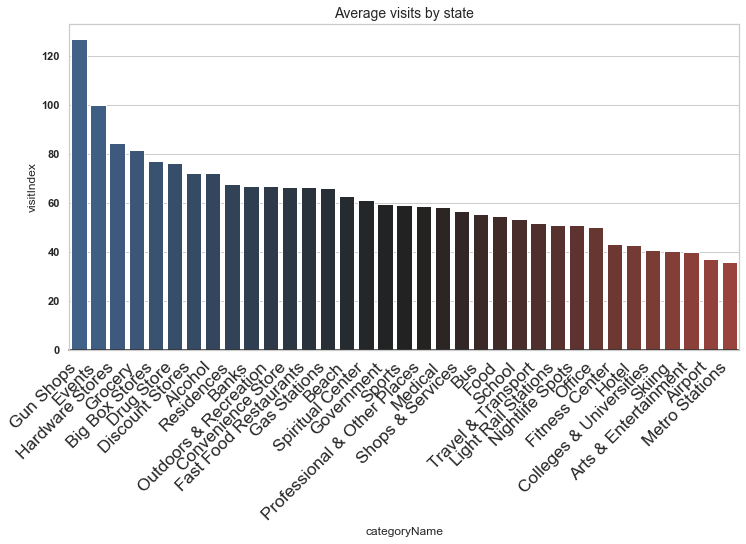

In [703]:
# 1. What businesses are being affected the most by covid

sns.set(style="whitegrid")
plt.figure(figsize=(12, 6))

# If we want to color just 1 value
# clrs = ["Red" if (x < 100) else "Green" for x in mean_vc.visitIndex]
#sb.barplot(x=idx, y=values, palette=clrs) # color=clrs)
#pal = sns.color_palette("Reds", len(mean_vc))
pal = sns.diverging_palette(250, 15, s=75, l=40,n=len(mean_vc), center="dark")

ax = sns.barplot(x="categoryName", y="visitIndex", palette=pal, data=mean_vc)
ax.axhline(0, color="k", clip_on=False)
#ax.set_xticklabels(list(df.categoryName.values),rotation=45, horizontalalignment='right')

plt.xticks(
    rotation=45, 
    horizontalalignment='right',
    fontweight='light',
    fontsize='x-large'  
)

ax.set_title('Average visits by state',fontsize=14)

#clrs = ['grey' if (x < max(values)) else 'red' for x in values ]
#sb.barplot(x=idx, y=values, palette=clrs) # color=clrs)

In [699]:
# Is that the same for all 3 states?
ga = pd.read_csv('groupedGeorgia.csv')
ny = pd.read_csv('groupedNewYork.csv')
ny_by_state = ny.groupby(["state", "categoryName", "date"])["visitIndex"].mean().reset_index()
frames = [df, ga,ny_by_state]
master = pd.concat(frames, ignore_index=True,sort=False)
master.head()

,date,state,categoryName,visitIndex,visitIndexOver65,visitIndexUnder65,rank,datetime,day
0,2020-03-01,California,Food,100.0,97.0,100.0,1.0,2020-03-01,Sunday
1,2020-03-01,California,Shops & Services,102.0,100.0,102.0,2.0,2020-03-01,Sunday
2,2020-03-01,California,Grocery,95.0,95.0,95.0,3.0,2020-03-01,Sunday
3,2020-03-01,California,Outdoors & Recreation,94.0,92.0,94.0,4.0,2020-03-01,Sunday
4,2020-03-01,California,Arts & Entertainment,102.0,101.0,102.0,5.0,2020-03-01,Sunday


# Business per state

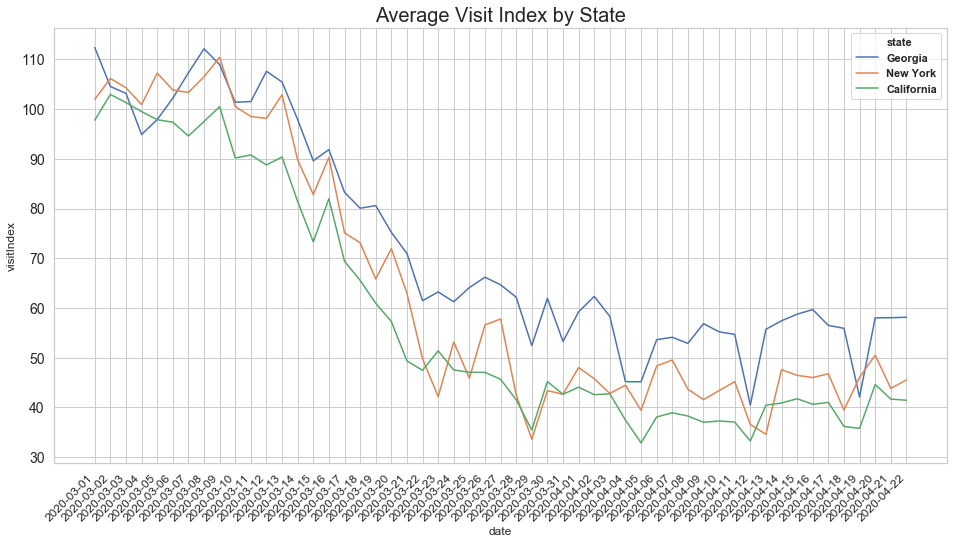

In [700]:
sns.set(style="whitegrid")

plt.figure(figsize=(16, 8))

sel = master[master['categoryName'].isin(['Hardware Stores', 'Grocery','Alcohol','Gas Stations','Gun Shops'])]

average_state = master.groupby(['state','date'])['visitIndex'].mean().reset_index().sort_values(by='visitIndex',ascending=False)


sns.lineplot(x=average_state["date"], 
             y=average_state["visitIndex"], 
             hue=average_state["state"])

plt.title('Average Visit Index by State', fontsize=20)
plt.xticks(
    rotation=45, 
    horizontalalignment='right',
    fontweight='light',
    fontsize=12  
)

plt.yticks(
    fontweight='light',
    fontsize=14  
)

plt.show()

- The **weekend effect** for all 3 very different states is **clear!**

# 2. How does day of the week affect footfall?

In [266]:
# Also look at month

,date,state,categoryName,visitIndex,visitIndexOver65,visitIndexUnder65,rank,datetime,day
0,2020-03-01,California,Food,100.0,97.0,100.0,1,2020-03-01,Sunday
1,2020-03-01,California,Shops & Services,102.0,100.0,102.0,2,2020-03-01,Sunday
2,2020-03-01,California,Grocery,95.0,95.0,95.0,3,2020-03-01,Sunday
3,2020-03-01,California,Outdoors & Recreation,94.0,92.0,94.0,4,2020-03-01,Sunday
4,2020-03-01,California,Arts & Entertainment,102.0,101.0,102.0,5,2020-03-01,Sunday
...,...,...,...,...,...,...,...,...,...
1737,2020-04-22,California,Bus,33.0,37.0,33.0,29,2020-04-22,Wednesday
1738,2020-04-22,California,Light Rail Stations,31.0,34.0,31.0,30,2020-04-22,Wednesday
1739,2020-04-22,California,Metro Stations,15.0,NaN,15.0,31,2020-04-22,Wednesday
1740,2020-04-22,California,Spiritual Center,48.0,50.0,48.0,32,2020-04-22,Wednesday


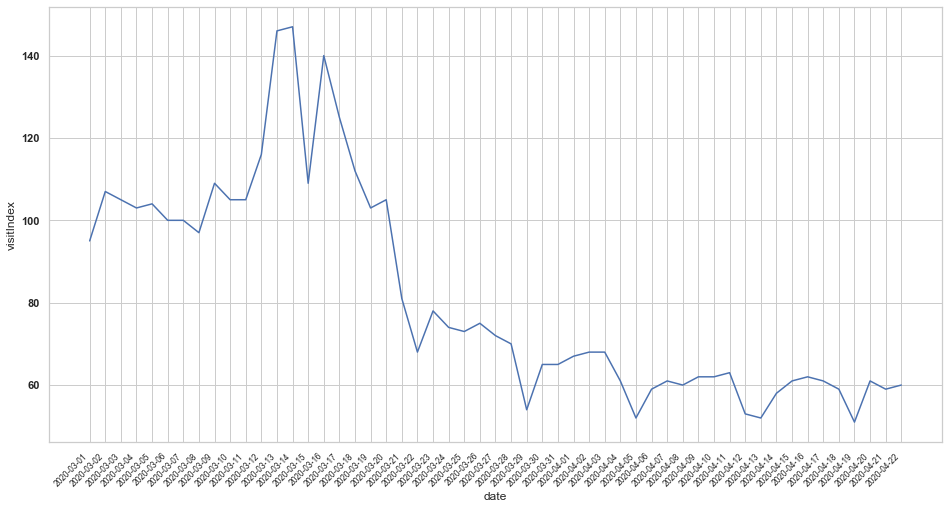

In [292]:
# Plot groceries by date
df_grocery = df[df.categoryName=='Grocery']

sns.set(style="whitegrid")

plt.figure(figsize=(16, 8))

sns.lineplot(x=df_grocery["date"], y=df_grocery["visitIndex"])


plt.xticks(
    rotation=45, 
    horizontalalignment='right',
    fontweight='light',
    fontsize='x-small'  
)

#plt.show()

- The pattern above makes sense - before the lockdown in California, people panic bought
- Since then, visit frequencies in groceries have dramatically dropped, especially on **weekends**
- This could potentially inform the decision of:

a) When should you encourage people to go shopping or
b) Should the shops be open on days that are low? 

In [288]:
# Only choose dates following initial spike
df_day = df_grocery[df_grocery['date'] > '2020-03-22'].groupby('day').mean().reset_index()

,day,visitIndex,visitIndexOver65,visitIndexUnder65,rank
0,Friday,65.75,57.00,66.00,3.00
1,Monday,63.00,59.60,63.20,3.20
2,Saturday,63.25,52.25,63.75,3.00
3,Sunday,52.50,44.25,53.00,2.75
4,Thursday,66.75,58.50,67.00,3.00
5,Tuesday,63.40,60.20,63.60,3.20
6,Wednesday,64.20,56.20,64.40,3.20


In [295]:
# Weekends are the least busy days!
df_day['visitIndex'].mean()

62.692857142857136

In [312]:
ga.head()

,date,state,categoryName,visitIndex,visitIndexOver65,visitIndexUnder65,rank
0,2020-03-01,Georgia,Food,112.0,105.0,112.0,1
1,2020-03-01,Georgia,Shops & Services,115.0,105.0,115.0,2
2,2020-03-01,Georgia,Grocery,99.0,96.0,99.0,3
3,2020-03-01,Georgia,Gas Stations,111.0,112.0,111.0,4
4,2020-03-01,Georgia,Fast Food Restaurants,118.0,116.0,118.0,5


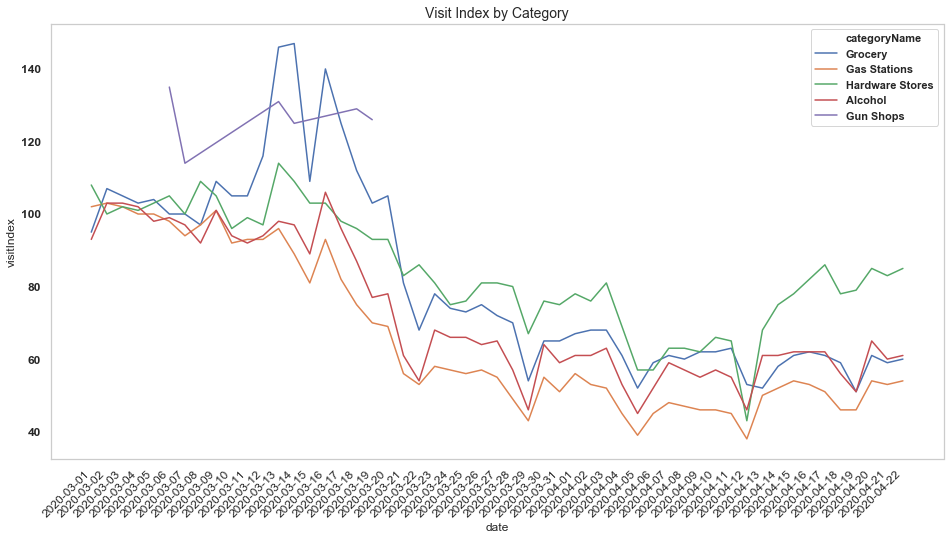

In [689]:
sns.set_style("whitegrid", {'axes.grid' : False})

plt.figure(figsize=(16, 8))

df_g_h_al = df[df['categoryName'].isin(['Hardware Stores', 'Grocery','Alcohol','Gas Stations','Gun Shops'])]

s = sns.lineplot(x=df_g_h_al["date"], 
             y=df_g_h_al["visitIndex"], 
             hue=df_g_h_al["categoryName"])

plt.title('Visit Index by Category', fontsize=14)
plt.xticks(
    rotation=45, 
    horizontalalignment='right',
    fontweight='light',
    fontsize=12
)

plt.yticks(fontsize=12)
plt.show()



- Pattern consistent for other categories as well! 
- If we want to re-open, we should balance the flow by day of week. 
- From the census we can get population data by county, this can tell us how many people we should contact when to visit at different times

In [305]:
# The cost function must minimize the difference between the means
mean = df_day['visitIndex'].mean()
visitindex = list(df_day['visitIndex'])

def get_cost(visitindex,mean):
    difference = [abs(i-mean) for i in visitindex]
    total = sum(difference)
    return difference, total

In [304]:
visitindex = list(df_day['visitIndex'])
difference = [abs(i-mean) for i in visitindex]
total = sum(difference)
total

20.38571428571432

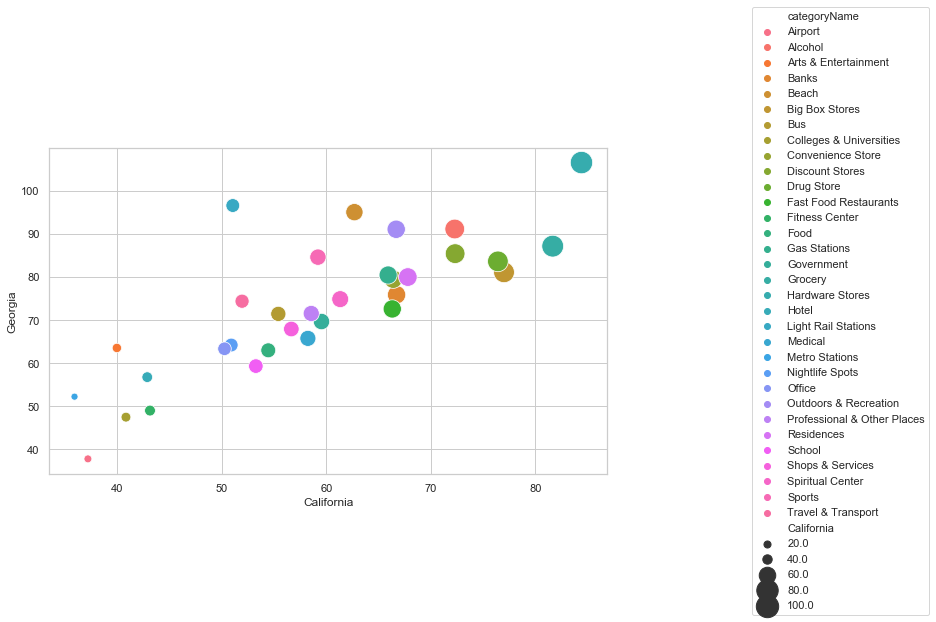

In [197]:
# Scatter plot California vs Georgia businesses'
# The categories labels are not the same

merge = pd.merge(ca, ga, how='inner', on='categoryName',
        left_index=False, right_index=False, sort=True,
         suffixes=('_x', '_y'), copy=True, indicator=False,
         validate=None).reset_index()

merge = merge.rename(columns={'visitIndex_x': 'California'})
merge = merge.rename(columns={'visitIndex_y': 'Georgia'})

plt.figure(figsize=(10, 6))

ax = sns.scatterplot(x=merge['California'], 
                     y=merge['Georgia'],
                     hue=merge['categoryName'],
                     size=merge['California'],
                     sizes=(50, 500),
                     data=merge)

 
# Move the legend to an empty part of the plot
#plt.legend(loc='lower right')

ax.legend(loc='center left', bbox_to_anchor=(1.25, 0.5), ncol=1)
 
#sns.plt.show()


In [306]:
df_day['difference'],total = get_cost(visitindex,mean)

# Heat map of county by day

In [ ]:
# Get the California raw data
# For illustration, get by day, differences in mean by county,
# The bigger the difference the more red

In [324]:
ca = pd.read_csv('rawCalifornia.csv')
ca.head()

,date,state,county,categoryId,categoryName,visitIndex,visitIndexOver65,visitIndexUnder65,rank
0,2020-03-01,California,Merced County,4bf58dd8d48988d113951735,Gas Stations,111.0,209.0,108.0,1
1,2020-03-01,California,Merced County,52f2ab2ebcbc57f1066b8b42,Big Box Stores,108.0,NaN,109.0,2
2,2020-03-01,California,Merced County,4bf58dd8d48988d16e941735,Fast Food Restaurants,118.0,NaN,118.0,3
3,2020-03-01,California,Merced County,4bf58dd8d48988d118951735,Grocery Stores,83.0,NaN,83.0,4
4,2020-03-01,California,Merced County,4bf58dd8d48988d1c1941735,Mexican Restaurants,107.0,NaN,108.0,5


In [331]:
inc = pd.read_csv('California Fact Sheet - Master.csv')
inc = inc.rename(columns={"County": "county", "County.1": "county_nw"})
inc.head()

,Rank,county,county_nw,Population,Median income,Median Income Number
0,6,Santa Clara County,Santa Clara,"1,922,200","$110,800",110800
1,14,San Mateo County,San Mateo,"765,935","$107,100",107100
2,26,Marin County,Marin,"260,295","$103,500",103500
3,12,San Francisco County,San Francisco,"870,044","$101,900",101900
4,9,Contra Costa County,Contra Costa,"1,133,247","$90,900",90900


In [332]:
ca_full = pd.merge(ca, inc, how='inner', on='county',
        left_index=False, right_index=False, sort=True,
         suffixes=('_ca', '_inc'), copy=True, indicator=False,
         validate=None).reset_index()

In [333]:
ca_full.head().sort_values(by='county')

,index,date,state,county,categoryId,categoryName,visitIndex,visitIndexOver65,visitIndexUnder65,rank,Rank,county_nw,Population,Median income,Median Income Number
0,0,2020-03-01,California,Alameda County,4bf58dd8d48988d1fd941735,Shopping Malls,104.0,97.0,104.0,1,7,Alameda,"1,643,700","$89,500",89500
1,1,2020-03-01,California,Alameda County,4bf58dd8d48988d118951735,Grocery Stores,102.0,102.0,102.0,2,7,Alameda,"1,643,700","$89,500",89500
2,2,2020-03-01,California,Alameda County,4bf58dd8d48988d113951735,Gas Stations,100.0,107.0,100.0,3,7,Alameda,"1,643,700","$89,500",89500
3,3,2020-03-01,California,Alameda County,4bf58dd8d48988d163941735,Parks,104.0,87.0,104.0,4,7,Alameda,"1,643,700","$89,500",89500
4,4,2020-03-01,California,Alameda County,4bf58dd8d48988d1e0931735,Coffee Shops,97.0,97.0,97.0,5,7,Alameda,"1,643,700","$89,500",89500


In [625]:
# Ok, now set up data!
# Add a variable for day
ca_full['datetime'] = pd.to_datetime(ca_full.date)
ca_full['day'] = ca_full['datetime'].dt.day_name()


# Then, create average visit index per county, starting after work from home order
# The data will still be messy because the first couple of days are affected by shutdown!

ca_pwork = ca_full[ca_full['date'] > '2020-03-19']
ca_agg = ca_pwork.groupby(['county','county_nw','day','categoryName'])['visitIndex'].mean().reset_index()

# The cost function must minimize the difference between the means
mean = ca_agg['visitIndex'].mean()
visitindex = list(ca_agg['visitIndex'])

ca_agg['difference'],total_diff = get_cost(visitindex,mean)

In [356]:
# Now we have our data preprocessed!
ca_agg
# Perfect, difference is the variable that will change color!

,county,county_nw,day,categoryName,visitIndex,difference
0,Alameda County,Alameda,Friday,Airports,32.000000,19.247002
1,Alameda County,Alameda,Friday,Automotive Shops,52.750000,1.502998
2,Alameda County,Alameda,Friday,Banks,55.500000,4.252998
3,Alameda County,Alameda,Friday,Big Box Stores,69.000000,17.752998
4,Alameda County,Alameda,Friday,Burger Joints,41.250000,9.997002
...,...,...,...,...,...,...
5404,Yolo County,Yolo,Wednesday,Big Box Stores,89.000000,37.752998
5405,Yolo County,Yolo,Wednesday,Gas Stations,65.600000,14.352998
5406,Yolo County,Yolo,Wednesday,Parks,69.000000,17.752998
5407,Yolo County,Yolo,Wednesday,Shopping Plazas,66.333333,15.086331


In [559]:
# We don't have all the data points but oh well!
len(ca_agg['county'].unique())

# Make this into a string so that whatever data comes out of it can merge
ca_agg['county_nw'] = ca_agg['county'].astype(str)
ca_agg['county_nw'] = [i.strip() for i in ca_agg['county'].values]

In [562]:
ca_agg

,county,county_nw,day,categoryName,visitIndex,difference
0,Alameda County,Alameda County,Friday,Airports,32.000000,19.247002
1,Alameda County,Alameda County,Friday,Automotive Shops,52.750000,1.502998
2,Alameda County,Alameda County,Friday,Banks,55.500000,4.252998
3,Alameda County,Alameda County,Friday,Big Box Stores,69.000000,17.752998
4,Alameda County,Alameda County,Friday,Burger Joints,41.250000,9.997002
...,...,...,...,...,...,...
5404,Yolo County,Yolo County,Wednesday,Big Box Stores,89.000000,37.752998
5405,Yolo County,Yolo County,Wednesday,Gas Stations,65.600000,14.352998
5406,Yolo County,Yolo County,Wednesday,Parks,69.000000,17.752998
5407,Yolo County,Yolo County,Wednesday,Shopping Plazas,66.333333,15.086331


In [512]:
import geopandas as gpd

# Import shapefile
shapefile = "cb_2018_us_county_20m.shp"
gdf = gpd.read_file(shapefile)

#gdf.head()
# Name represents county name, stateFP for California is 6
gdf[(gdf.NAME == "Alameda")&(gdf.STATEFP== '06')]

# Get just California
ca_gdf = gdf[gdf.STATEFP== '06']
ca_gdf = ca_gdf[['NAME','geometry']]
ca_gdf.columns = ['county','geometry']
ca_gdf.head()


,county,geometry
182,Modoc,"POLYGON ((-121.45721 41.94994, -121.44754 41.9..."
535,Napa,"POLYGON ((-122.62740 38.66751, -122.46389 38.7..."
1003,Stanislaus,"POLYGON ((-121.47192 37.48178, -121.24122 37.6..."
1006,San Joaquin,"POLYGON ((-121.58002 38.09441, -121.47214 38.2..."
1074,Colusa,"POLYGON ((-122.78509 39.38297, -122.73906 39.3..."


In [513]:
ca_agg_friday = ca_agg[(ca_agg['day'] == 'Friday')&(ca_agg['categoryName'] == 'Supermarkets')][['county_nw','visitIndex','difference']]
ca_agg_friday.columns = ['county','visitIndex','difference']
ca_agg_friday.head()

,county,visitIndex,difference
32,Alameda,85.50,34.252998
200,Butte,104.00,52.752998
233,Contra Costa,84.25,33.002998
386,Fresno,70.50,19.252998
596,Kern,78.00,26.752998


In [580]:
# Add ca_agg to this! 
merged = ca_gdf.merge(ca_agg_friday,
                      how='left', 
                      left_on = 'county', 
                      right_on = 'county',
                      left_index=False, 
                      right_index=False, 
                      sort=True,)


In [583]:
merged.head()
#Replace NaN values to string 'No data'.
#merged['difference'].fillna(value=0,inplace = True)

,county,geometry,county_id,visitIndex,difference
0,Alameda,"POLYGON ((-122.33371 37.80980, -122.30393 37.8...",10,85.5,34.252998
1,Alpine,"POLYGON ((-120.07248 38.50987, -120.07239 38.7...",9,NaN,0.000000
2,Amador,"POLYGON ((-121.02751 38.50829, -120.92711 38.5...",48,NaN,0.000000
3,Butte,"POLYGON ((-122.04487 39.88377, -121.80404 39.8...",34,104.0,52.752998
4,Calaveras,"POLYGON ((-120.99550 38.22540, -120.89286 38.2...",18,NaN,0.000000


In [572]:
#ca_gdf.columns = ca_gdf.columns.str.replace(' ', '')
#ca_agg_friday.columns = ca_agg_friday.columns.str.replace(' ', '')

over = list(set(ca_gdf['county'].values) & set(ca_agg_friday['county'].values)) 
over[:3]

['Butte', 'Riverside', 'Kern']

In [571]:
ca_gdf['county'] = ca_gdf['county'].astype(str)
ca_agg_friday['county'] = ca_agg_friday['county'].astype(str)

ca_gdf['county']  = [i.strip() for i in ca_gdf['county'].values]
ca_agg_friday['county'] = [i.strip() for i in ca_agg_friday['county'].values]

(array(['Modoc', 'Napa', 'Stanislaus', 'San Joaquin', 'Colusa', 'Humboldt',
        'Trinity', 'Kern', 'Ventura', 'Alpine', 'Alameda', 'Siskiyou',
        'Yuba', 'Los Angeles', 'Mendocino', 'Madera', 'Santa Barbara',
        'Contra Costa', 'Calaveras', 'Fresno', 'Tulare', 'Lake',
        'Monterey', 'San Francisco', 'San Mateo', 'Tuolumne', 'Sierra',
        'San Diego', 'Solano', 'Marin', 'Lassen', 'Yolo', 'Riverside',
        'Sonoma', 'Butte', 'Imperial', 'Nevada', 'Mono', 'Sutter',
        'Merced', 'Santa Cruz', 'Santa Clara', 'Placer', 'Del Norte',
        'Mariposa', 'San Benito', 'Orange', 'San Bernardino', 'Amador',
        'Tehama', 'Shasta', 'Glenn', 'Plumas', 'Inyo', 'Sacramento',
        'Kings', 'El Dorado', 'San Luis Obispo'], dtype=object),
 array(['Alameda', 'Butte', 'Contra Costa', 'Fresno', 'Kern',
        'Los Angeles', 'Orange', 'Placer', 'Riverside', 'Sacramento',
        'San Bernardino', 'San Diego', 'San Joaquin', 'San Mateo',
        'Santa Clara', 'Solano',

In [584]:
import json
merged_json = json.loads(merged.to_json())
#Convert to String like object.
json_data = json.dumps(merged_json)

In [680]:
from bokeh.io import output_notebook, show, output_file
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar
from bokeh.palettes import brewer

#Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = json_data)
#Define a sequential multi-hue color palette.
palette = brewer['RdYlBu'][8]


#Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
color_mapper = LinearColorMapper(palette = palette, low = 0, high = 40)
#Define custom tick labels for color bar.
tick_labels = {'0': '0%', '5': '5%', '10':'10%', '15':'15%', '20':'20%', '25':'25%', '30':'30%','35':'35%', '40': '>40%'}
#Create color bar. 
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels)

#Create figure object.
p = figure(title = 'Footfall by day of week, Friday', plot_height = 600 , plot_width = 400, toolbar_location = None)
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None

#Add patch renderer to figure. 
p.patches('xs','ys', source = geosource,fill_color = {'field' :'difference', 'transform' : color_mapper},
          line_color = 'black', line_width = 0.25, fill_alpha = 1)
#Specify figure layout.
p.add_layout(color_bar, 'below')
p.xaxis.major_label_text_font_size = '0pt'  # turn off x-axis tick labels
p.yaxis.major_label_text_font_size = '0pt'  # turn off y-axis tick labels

#Display figure inline in Jupyter Notebook.
output_notebook()
#Display figure.
show(p)

Loading BokehJS ...

In [627]:
# Renaming a column df.rename(columns={"A": "a"})
ca_pwork.head()

# Create data set with all the values
ca_group = ca_pwork.groupby(['county','county_nw','day','categoryName','Population','Median Income Number'])['visitIndex'].mean().reset_index()

# Format data points
ca_group['county_nw'] = ca_group['county_nw'].astype(str)
ca_group['county_nw'] = [i.strip() for i in ca_group['county_nw'].values]

#Add y outcome roles
mean = ca_group['visitIndex'].mean()
visitindex = list(ca_group['visitIndex'])

ca_group['difference'],total_diff = get_cost(visitindex,mean)
ca_group['mean'] = mean
ca_group.head()

,county,county_nw,day,categoryName,Population,Median Income Number,visitIndex,difference,mean
0,Alameda County,Alameda,Friday,Airports,"1,643,700",89500,32.00,19.247002,51.247002
1,Alameda County,Alameda,Friday,Automotive Shops,"1,643,700",89500,52.75,1.502998,51.247002
2,Alameda County,Alameda,Friday,Banks,"1,643,700",89500,55.50,4.252998,51.247002
3,Alameda County,Alameda,Friday,Big Box Stores,"1,643,700",89500,69.00,17.752998,51.247002
4,Alameda County,Alameda,Friday,Burger Joints,"1,643,700",89500,41.25,9.997002,51.247002


In [628]:
# Create a dictionary of day id's
d_id = {'Monday':1,'Tuesday':2, 'Wednesday':3,'Thursday':4,'Friday':5,'Saturday':6,'Sunday':7}

ca_group["day_id"] = ca_group["day"].apply(lambda x: d_id.get(x))
ca_group

,county,county_nw,day,categoryName,Population,Median Income Number,visitIndex,difference,mean,day_id
0,Alameda County,Alameda,Friday,Airports,"1,643,700",89500,32.000000,19.247002,51.247002,5
1,Alameda County,Alameda,Friday,Automotive Shops,"1,643,700",89500,52.750000,1.502998,51.247002,5
2,Alameda County,Alameda,Friday,Banks,"1,643,700",89500,55.500000,4.252998,51.247002,5
3,Alameda County,Alameda,Friday,Big Box Stores,"1,643,700",89500,69.000000,17.752998,51.247002,5
4,Alameda County,Alameda,Friday,Burger Joints,"1,643,700",89500,41.250000,9.997002,51.247002,5
...,...,...,...,...,...,...,...,...,...,...
5404,Yolo County,Yolo,Wednesday,Big Box Stores,"214,977",63600,89.000000,37.752998,51.247002,3
5405,Yolo County,Yolo,Wednesday,Gas Stations,"214,977",63600,65.600000,14.352998,51.247002,3
5406,Yolo County,Yolo,Wednesday,Parks,"214,977",63600,69.000000,17.752998,51.247002,3
5407,Yolo County,Yolo,Wednesday,Shopping Plazas,"214,977",63600,66.333333,15.086331,51.247002,3


In [690]:
# Create json
import json
from bokeh.models.widgets import Slider,Select,CheckboxGroup
from bokeh.io import output_notebook, show, output_file
from bokeh.layouts import widgetbox, column
from bokeh.models import Slider, ColumnDataSource, CustomJS,CDSView, IndexFilter, BooleanFilter, HoverTool,GeoJSONDataSource, LinearColorMapper, ColorBar,BasicTicker, PrintfTickFormatter
from bokeh.plotting import figure, curdoc,output_file, show, ColumnDataSource
from bokeh.core.properties import value
from bokeh.models.ranges import FactorRange
from bokeh.palettes import brewer

#output_file("california.html")

# Full data set
merged = ca_gdf.merge(ca_group, left_on = 'county', right_on ='county_nw', how = 'left',suffixes=('_g', '_ca'))
merged['difference'].fillna(value=0,inplace = True)
merged_json = json.loads(merged.to_json())
json_data = json.dumps(merged_json)
geosource_all = GeoJSONDataSource(geojson =  json_data)

# Set the start date
#current_week=ColumnDataSource(ca_group[ca_group['day']== 'Monday'])
current_day = 1
current_cat='Supermarkets'

# Start data set
df_curr = ca_group[(ca_group['day_id']==current_day)&(ca_group['categoryName']==current_cat)]
merged_curr = ca_gdf.merge(df_curr, left_on = 'county', right_on ='county_nw', how = 'left',suffixes=('_g', '_ca'))
merged_curr['difference'].fillna(value=0,inplace = True)
merged_json_curr = json.loads(merged_curr.to_json())
json_data_curr = json.dumps(merged_json_curr)
geosource_curr = GeoJSONDataSource(geojson =  json_data_curr)

#Filter all data to not have Monday
boolinit = (merged['day_id']==current_day)&(merged['categoryName']==current_cat)
view = CDSView(source=geosource_all, filters=[BooleanFilter(boolinit)])
hover3 = HoverTool(tooltips = [('County', '@county_nw'),('difference','@difference')])

#Define a sequential multi-hue color palette.
palette = brewer['RdYlBu'][8]


#Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors. Input nan_color.
color_mapper = LinearColorMapper(palette = palette, low = 0, high = 8, nan_color = '#d9d9d9')

#Define custom tick labels for color bar.
tick_labels = {'0': '0%', '5': '5%', '10':'10%', '15':'15%', '20':'20%', '25':'25%', '30':'30%','35':'35%', '40': '>40%'}

color_bar = ColorBar(color_mapper=color_mapper, 
                     ticker=BasicTicker(desired_num_ticks=len(palette)),
                     formatter=PrintfTickFormatter(format="%d%%"),
                     label_standoff=6, 
                     border_line_color=None,
                     height = 20,
                     orientation = 'horizontal',
                     major_label_overrides = tick_labels,
                     location=(0, 0))

#Create figure object.
p =  figure(title='How does footfall vary across days?', 
            plot_width=400, 
            plot_height=600, min_border=3,
            tools = [hover3,'box_zoom','wheel_zoom', 'pan','reset'],
            toolbar_location="above")

p.title.text_font_size = '14pt'
p.title.text_color = "darkblue"
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None


#Add patch renderer to figure. 
p.patches('xs','ys', 
          source = geosource_curr,
          fill_color = {'field' :'difference', 'transform' : color_mapper},
          line_color = 'black', line_width = 0.25, fill_alpha = 1)

p.add_layout(color_bar, 'below')
p.xaxis.major_label_text_font_size = '0pt'  # turn off x-axis tick labels
p.yaxis.major_label_text_font_size = '0pt'  # turn off y-axis tick labels

callback = CustomJS(args=dict(source=geosource_all, sc=geosource_curr), code="""       
        var f = slider.value;
        var s = select.value;
        sc.data['county_nw'] = [];
        sc.data['day_id'] = [];
        sc.data['difference'] = [];
        sc.data['categoryName'] = [];
        for (var i = 0; i <= source.get_length(); i++){
          if ((source.data['day_id'][i] == f ) & (source.data['categoryName'][i] == s )){
            sc.data['day_id'].push(source.data['day_id'][i])
            sc.data['categoryName'].push(source.data['categoryName'][i])
            sc.data['difference'].push(source.data['difference'][i])
            sc.data['county_nw'].push(source.data['county_nw'][i])
          }
        }
        sc.change.emit();
    """)

# select = Select(options=["201951","201952","201953"], title="Week", callback=callback)
# callback.args["select"] = select
# layout = column(select, p)

slider = Slider(start=1, end=7, value=current_day, step=1, title="Day", callback=callback)
callback.args["slider"] = slider
# Add a selector for category
catlist = list(set(ca_agg['categoryName']))
select = Select(title="Category Name:", options= catlist, value=current_cat,callback=callback)
callback.args["select"] = select

slider.js_on_change('value', callback)
select.js_on_change('value', callback)

#layout = column(slider, p)

layout = column(p,widgetbox(slider,select))
#curdoc().add_root(layout)

#Display plot inline in Jupyter notebook
output_notebook()

show(layout)


Loading BokehJS ...

In [616]:
merged_curr.head()

,county_g,geometry,county_id,county_ca,county_nw,day,categoryName,Population,Median Income Number,visitIndex,difference,mean
0,Modoc,"POLYGON ((-121.45721 41.94994, -121.44754 41.9...",0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN
1,Napa,"POLYGON ((-122.62740 38.66751, -122.46389 38.7...",1,Napa County,Napa,Monday,Wineries,"140,530",73100.0,45.333333,5.913669,51.247002
2,Stanislaus,"POLYGON ((-121.47192 37.48178, -121.24122 37.6...",2,Stanislaus County,Stanislaus,Monday,Big Box Stores,"539,301",54100.0,62.400000,11.152998,51.247002
3,Stanislaus,"POLYGON ((-121.47192 37.48178, -121.24122 37.6...",2,Stanislaus County,Stanislaus,Monday,Coffee Shops,"539,301",54100.0,54.000000,2.752998,51.247002
4,Stanislaus,"POLYGON ((-121.47192 37.48178, -121.24122 37.6...",2,Stanislaus County,Stanislaus,Monday,Convenience Stores,"539,301",54100.0,64.200000,12.952998,51.247002


In [692]:
from bokeh.io import curdoc, output_notebook
from bokeh.models import Slider, HoverTool
from bokeh.layouts import widgetbox, row, column
#Define function that returns json_data for year selected by user.

#Display plot inline in Jupyter notebook
output_notebook()
#output_file("Covid_hack.html")

def json_data(day,category,df):
        # Create variables
        day = day
        category = category
        # Create selection
        df_curr = df[(df['day_id']==day)&(df['categoryName']==category)]

        merged_curr = ca_gdf.merge(df_curr, left_on = 'county', right_on ='county_nw', how = 'left',suffixes=('_g', '_ca'))
        merged_curr['difference'].fillna(value=0,inplace = True)
        merged_json_curr = json.loads(merged_curr.to_json())
        json_data = json.dumps(merged_json_curr)
        return json_data

#Create the json based on specifications
geosource = GeoJSONDataSource(geojson =json_data(1,'Supermarkets',ca_group))

#Define a sequential multi-hue color palette.
palette = brewer['RdYlBu'][8]

#Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors. Input nan_color.
color_mapper = LinearColorMapper(palette = palette, low = 0, high = 40, nan_color = '#d9d9d9')
#Define custom tick labels for color bar.
tick_labels = {'0': '0%', '5': '5%', '10':'10%', '15':'15%', '20':'20%', '25':'25%', '30':'30%','35':'35%', '40': '>40%'}
#Add hover tool
hover = HoverTool(tooltips = [ ('County','@country'),('difference', '@difference')])
#Create color bar. 
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
                     border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels)


#Create figure object.
p = figure(title = 'How does footfall vary across days?', 
           plot_height = 600 , 
           plot_width = 400, 
           toolbar_location = None, 
           tools = [hover])

p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None
#Add patch renderer to figure. 
p.patches('xs','ys', 
          source = geosource,
          fill_color = {'field' :'difference', 'transform' : color_mapper},
          line_color = 'black', line_width = 0.25, fill_alpha = 1)

#Specify layout
p.add_layout(color_bar, 'below')
p.xaxis.major_label_text_font_size = '0pt'  # turn off x-axis tick labels
p.yaxis.major_label_text_font_size = '0pt'  # turn off y-axis tick labels

# Define the callback function: update_plot
def update_plot(attr, old, new):
    # Get values of slider
    # Get dataframe
    day = slider.value
    category = select.value
    df = ca_group
    new_data = json_data(day,category,ca_group)
    geosource.geojson = new_data
    p.title.text = 'How does footfall vary across days, %d' %day

# Make a slider object: slider 
slider = Slider(start=1, end=7, value=1, step=1, title="Day")
slider.on_change('value', update_plot)
select = Select(title="Category Name:", options= catlist, value='Supermarkets')
select.on_change('value', update_plot)


# Make a column layout of widgetbox(slider) and plot, and add it to the current document
layout = column(p,widgetbox(slider,select))
curdoc().add_root(layout)


#Display plot
show(layout)

You are generating standalone HTML/JS output, but trying to use real Python
callbacks (i.e. with on_change or on_event). This combination cannot work.

Only JavaScript callbacks may be used with standalone output. For more
information on JavaScript callbacks with Bokeh, see:

    http://bokeh.pydata.org/en/latest/docs/user_guide/interaction/callbacks.html

Alternatively, to use real Python callbacks, a Bokeh server application may
be used. For more information on building and running Bokeh applications, see:

    http://bokeh.pydata.org/en/latest/docs/user_guide/server.html



You are generating standalone HTML/JS output, but trying to use real Python
callbacks (i.e. with on_change or on_event). This combination cannot work.

Only JavaScript callbacks may be used with standalone output. For more
information on JavaScript callbacks with Bokeh, see:

    http://bokeh.pydata.org/en/latest/docs/user_guide/interaction/callbacks.html

Alternatively, to use real Python callbacks, a Bokeh server application may
be used. For more information on building and running Bokeh applications, see:

    http://bokeh.pydata.org/en/latest/docs/user_guide/server.html



# For final project

a) Choose 10 states that are different
3 West Coast
- California 
2020-03-19
- Washington 
2020-03-23
- Oregon 
2020-03-23
4 Middle
- Tennessee 
2020-03-31
- Nebraska 
None
- Kansas 
2020-03-30
- Arkansa 
No stay at home order
3 East
- New York 
2020-03-22
- Georgia 
2020-04-03
- Maine 
2020-04-01

b) Plot How footfall has been affected by the state at home orders, average state

c) Assuming that each state is different, choose one (California), and create a map that shows hotspots of visitorsindex over the day

d) Show optimization and suggest how it could be implemented